In [1]:
# IMPORTING NECESSARY LIBRARIES

In [2]:
import pandas as pd
import numpy as np

import matplotlib
import matplotlib.pyplot as plt
from matplotlib import cm #colormap
import seaborn as sns

sns.set_style("dark")

from plotly.offline import init_notebook_mode, iplot, plot
import plotly as py
import plotly.graph_objs as go
init_notebook_mode(connected=True)

import geopandas as gpd
import mapclassify

In [3]:
# READING THE DATASET

In [4]:
suicides = pd.read_csv(r"C:\Users\DELL\Downloads\New folder\suicides\Suicides in India 2001-2012.csv")

In [5]:
import os
os.getcwd()

'C:\\Users\\DELL'

In [6]:
os.chdir(r"C:\Users\DELL\Downloads\New folder\indian states\Igismap")

In [7]:
os.listdir()

['Indian_States.dbf',
 'Indian_States.prj',
 'Indian_States.shp',
 'Indian_States.shx']

In [8]:
india = gpd.read_file(r"C:\Users\DELL\Downloads\New folder\indian states\Igismap\Indian_States.shp")

In [9]:
suicides.head(10)

,State,Year,Type_code,Type,Gender,Age_group,Total
0,A & N Islands,2001,Causes,Illness (Aids/STD),Female,0-14,0
1,A & N Islands,2001,Causes,Bankruptcy or Sudden change in Economic,Female,0-14,0
2,A & N Islands,2001,Causes,Cancellation/Non-Settlement of Marriage,Female,0-14,0
3,A & N Islands,2001,Causes,Physical Abuse (Rape/Incest Etc.),Female,0-14,0
4,A & N Islands,2001,Causes,Dowry Dispute,Female,0-14,0
5,A & N Islands,2001,Causes,Family Problems,Female,0-14,0
6,A & N Islands,2001,Causes,Ideological Causes/Hero Worshipping,Female,0-14,0
7,A & N Islands,2001,Causes,Other Prolonged Illness,Female,0-14,0
8,A & N Islands,2001,Causes,Property Dispute,Female,0-14,0
9,A & N Islands,2001,Causes,Fall in Social Reputation,Female,0-14,0


In [10]:
print(f"The size of the dataset:\n Rows:{suicides.shape[0]}\tColumns:{suicides.shape[1]}")

The size of the dataset:
 Rows:237519	Columns:7


In [11]:
suicides.isnull().sum()

State        0
Year         0
Type_code    0
Type         0
Gender       0
Age_group    0
Total        0
dtype: int64

In [12]:
# Data Pre-processing

In [13]:
suicides.columns

Index(['State', 'Year', 'Type_code', 'Type', 'Gender', 'Age_group', 'Total'], dtype='object')

In [14]:
suicides['State'].value_counts()

Madhya Pradesh       6792
Maharashtra          6792
Karnataka            6792
Odisha               6791
Andhra Pradesh       6791
Rajasthan            6791
Bihar                6790
Chhattisgarh         6790
Haryana              6790
Kerala               6788
Uttar Pradesh        6787
Assam                6786
Tamil Nadu           6786
Gujarat              6786
Jharkhand            6785
Tripura              6782
Delhi (Ut)           6782
West Bengal          6780
Punjab               6779
Himachal Pradesh     6774
Jammu & Kashmir      6761
Goa                  6759
Uttarakhand          6758
Sikkim               6742
Mizoram              6737
Meghalaya            6733
Puducherry           6730
Chandigarh           6717
A & N Islands        6712
Daman & Diu          6710
Arunachal Pradesh    6707
Nagaland             6705
D & N Haveli         6704
Manipur              6700
Lakshadweep          6674
Total (All India)     312
Total (States)        312
Total (Uts)           312
Name: State,

In [15]:
suicides.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 237519 entries, 0 to 237518
Data columns (total 7 columns):
 #   Column     Non-Null Count   Dtype 
---  ------     --------------   ----- 
 0   State      237519 non-null  object
 1   Year       237519 non-null  int64 
 2   Type_code  237519 non-null  object
 3   Type       237519 non-null  object
 4   Gender     237519 non-null  object
 5   Age_group  237519 non-null  object
 6   Total      237519 non-null  int64 
dtypes: int64(2), object(5)
memory usage: 12.7+ MB


In [16]:
suicides = suicides.drop(suicides[suicides.Total==0].index)

print("After Total = 0 is dropped",suicides['Type_code'].unique())

suicides = suicides.drop(suicides[(suicides['State'] == 'Total (Uts)') | (suicides['State'] == 'Total (All India)') | 
               (suicides['State'] == 'Total (States)') | (suicides['State'] == 'D & N Haveli') ].index)

print("After Amb. States are dropped",suicides['Type_code'].unique())

suicides = suicides.drop(suicides[(suicides['Age_group'] == '0-100+')].index)

print("After Age Group Amb is dropped",suicides['Type_code'].unique())

After Total = 0 is dropped ['Causes' 'Education_Status' 'Means_adopted' 'Professional_Profile'
 'Social_Status']
After Amb. States are dropped ['Causes' 'Education_Status' 'Means_adopted' 'Professional_Profile'
 'Social_Status']
After Age Group Amb is dropped ['Causes' 'Means_adopted' 'Professional_Profile']


In [17]:
suicides['State'].replace({'A & N Islands':'Andaman & Nicobar Island',
                        'Delhi (Ut)':'NCT of Delhi',
                       }, inplace = True)

india.rename(columns = {'st_nm':'State'}, inplace = True)
india['State'].replace({'Telangana':'Andhra Pradesh'
                       }, inplace = True)

In [18]:
# 1. YEARWISE OVERVIEW

In [19]:
trace1 = go.Bar(
    x = suicides['Year'].unique(),
    y = suicides.groupby('Year').sum()['Total']
)

layout = go.Layout()
fig = go.Figure(data = trace1, layout = layout)

fig.update_layout(
    title="Yearwise suicide",
    xaxis_title="Year",
    yaxis_title="Suicide Count",
)
fig.update_yaxes(tickangle=-30, tickfont=dict(size=7.5))

iplot(fig)

C:\Users\DELL\AppData\Local\Temp\ipykernel_25696\76156136.py:3: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



In [20]:
# 2. Major Geospatial Analysis Overview

In [21]:
suicides_states = suicides.groupby(['State']).agg({'Total':'sum','Year':'count'})
suicides_states.rename(columns = {'Year':'Cases Type Count'}, inplace = True)

In [22]:
# 2.1.statewise suicides map

C:\Users\DELL\AppData\Local\Temp\ipykernel_25696\4247188468.py:21: MatplotlibDeprecationWarning:

Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.



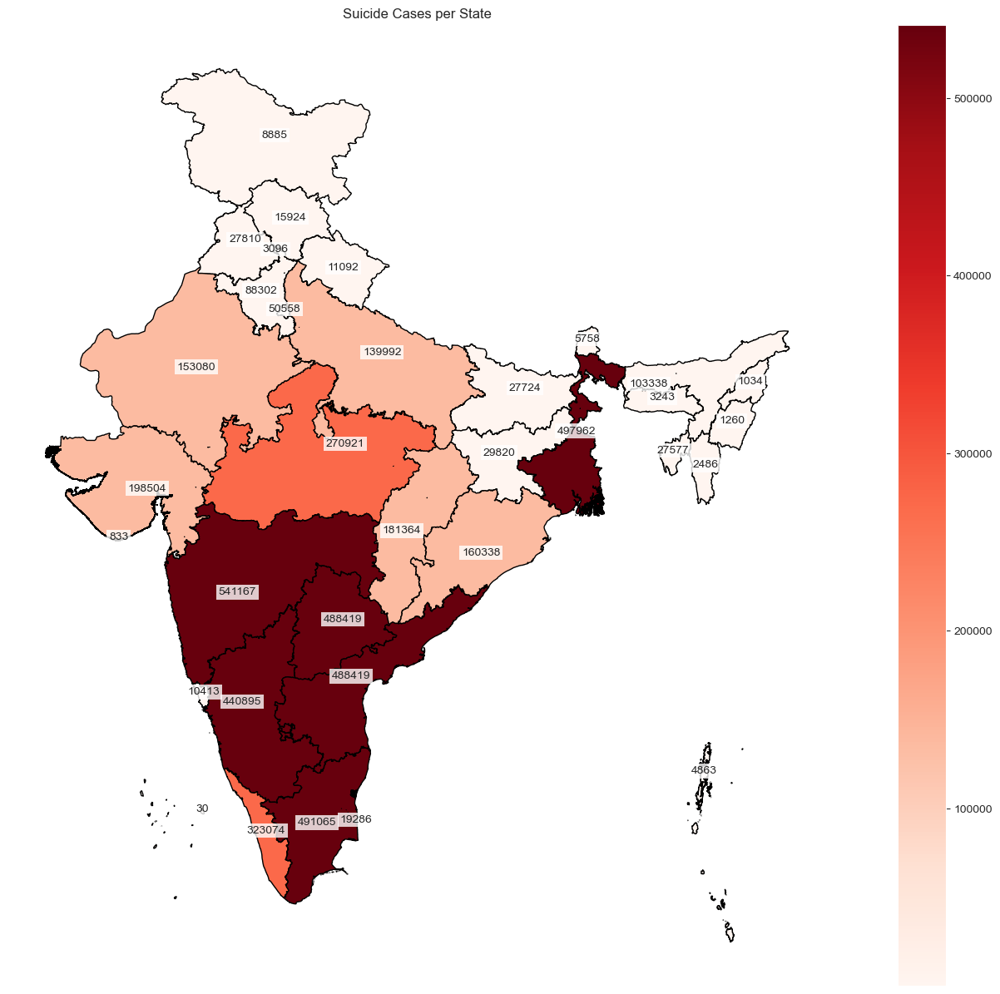

In [23]:
suicide_map = india.merge(suicides_states, left_on='State', right_on='State')

suicide_map['coords'] = suicide_map['geometry'].apply(lambda x: x.representative_point().coords[:])
suicide_map['coords'] = [coords[0] for coords in suicide_map['coords']]

fig, ax = plt.subplots(figsize=(22, 15))

cmap = 'Reds'

ax = suicide_map.plot(ax=ax, cmap=cmap,column = 'Total',scheme = 'equal_interval',edgecolor = 'black')
ax.set_facecolor('white')
ax.set_title('Suicide Cases per State')

for idx, row in suicide_map.iterrows():
   ax.text(row.coords[0], row.coords[1], s=row['Total'], 
           horizontalalignment='center', bbox={'facecolor': 'white', 'alpha':0.8, 'pad': 2, 'edgecolor':'none'})

norm = matplotlib.colors.Normalize(vmin=suicide_map['Total'].min(), vmax= suicide_map['Total'].max())
n_cmap = cm.ScalarMappable(cmap= cmap, norm = norm)
n_cmap.set_array([])
ax.get_figure().colorbar(n_cmap)

#suicide_map[suicide_map['Total'] > 0].plot(ax=ax, cmap=cmap, markersize=1)

plt.xticks([])
plt.yticks([])
plt.show()


In [24]:
# 2.2 bar plot statewise

In [25]:
trace1 = go.Bar(
    x = suicides_states.sort_values(by = ['Total'],ascending = False).index,
    y = suicides_states.sort_values(by = ['Total'],ascending = False)['Total']
)

layout = go.Layout()
fig = go.Figure(data = trace1, layout = layout)

fig.update_layout(
    title="Statewise Suicide Count",
    xaxis_title="State",
    yaxis_title="Suicide Count",
)

iplot(fig)

In [26]:
# 3. age

In [27]:
# 3.1 Age-Group Distribution of Suicide Cases

In [28]:
import plotly.express as px

df = px.data.tips()
fig = px.histogram(suicides, x="Age_group", y='Total',
                   color_discrete_sequence=['indianred','lightblue'],
                   marginal="violin", # or violin, rug
                  )

fig.update_layout(
    title="Suicide Cause",
    xaxis_title="Age Group",
    yaxis_title="Total Suicide Count",
)

fig.show()

In [29]:
# 3.2 Year-wise distribution of Age Groups

In [30]:
import plotly.express as px

df = px.data.tips()
fig = px.histogram(suicides, y="Age_group", x='Total',color = 'Year',
                   color_discrete_sequence = px.colors.qualitative.G10,
                   marginal=None, # or violin, rug
                  )

fig.update_layout(
    title="Suicide for Age Group, Year-wise",
    xaxis_title="Total Suicide Count",
    yaxis_title="Age Group",
)
fig.update_yaxes(tickangle=-30, tickfont=dict(size=7.5))

fig.show()

In [31]:
# 3.3 Geospatial Analysis (Young vs Elder)

In [32]:
suicides_agegroup = suicides.groupby(['Age_group','State']).sum()
suicides_agegroup

C:\Users\DELL\AppData\Local\Temp\ipykernel_25696\3805505476.py:1: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



Year  Total
Age_group State                                   
0-14      Andaman & Nicobar Island   166510    159
          Andhra Pradesh            1259889   9795
          Arunachal Pradesh          174580    147
          Assam                      708241   2197
          Bihar                      702218   1716
...                                     ...    ...
60+       Tamil Nadu                1739764  43959
          Tripura                    559846   1557
          Uttar Pradesh             1510845   8908
          Uttarakhand                407352    405
          West Bengal               1460485  29463

[168 rows x 2 columns]

In [33]:
# 3.3.1 Young Age Group State-wise Mapping

C:\Users\DELL\AppData\Local\Temp\ipykernel_25696\3221569219.py:25: MatplotlibDeprecationWarning:

Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.



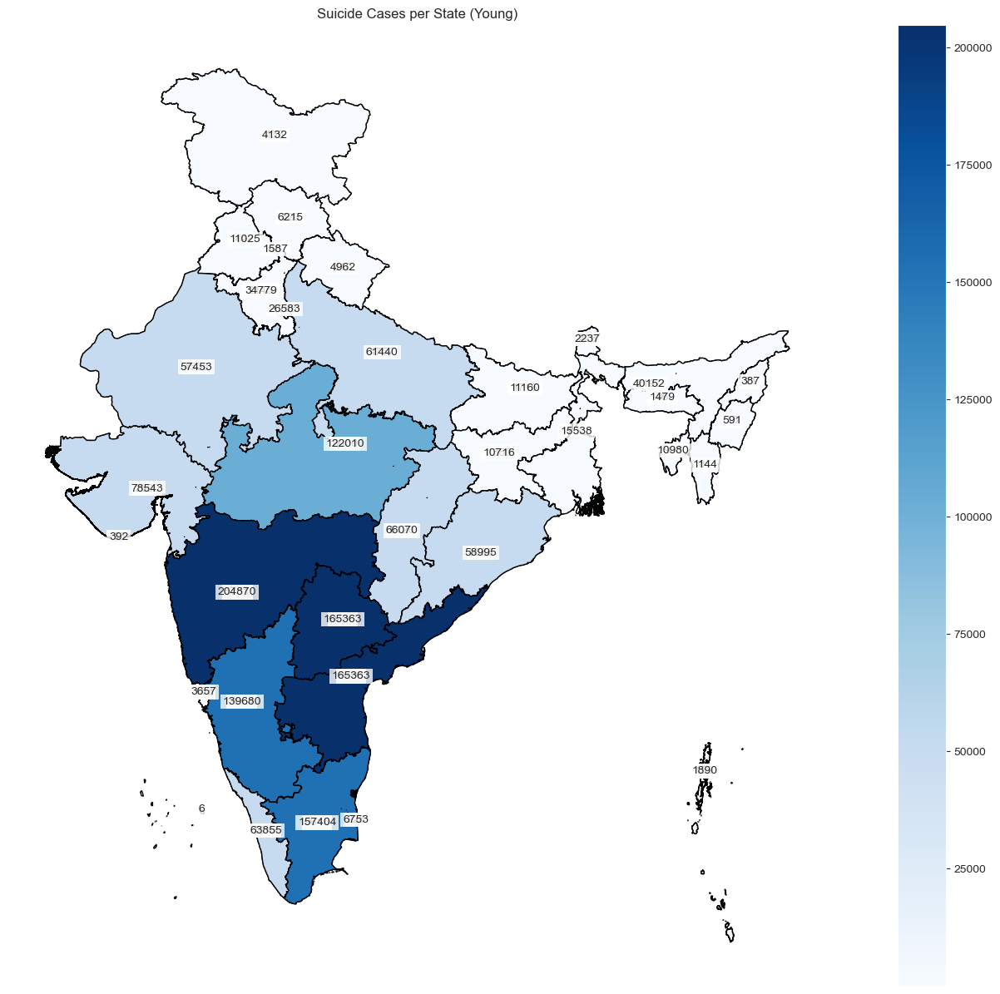

In [34]:
each_age_range = suicides_agegroup.shape[0]//suicides['Age_group'].nunique()

suicide_map_younger = india.merge(suicides_agegroup[:each_age_range*2], left_on= 'State', right_on = 'State')
suicide_map_elder = india.merge(suicides_agegroup[each_age_range*2:], left_on = 'State', right_on = 'State')

fig, ax = plt.subplots(figsize=(22, 15))

cmap = 'Blues'

ax = suicide_map_younger.plot(ax=ax, cmap=cmap,column = 'Total',scheme = 'equal_interval',edgecolor = 'black')
ax.set_facecolor('white')
ax.set_title('Suicide Cases per State (Young)')

suicide_map_younger['coords'] = suicide_map_younger['geometry'].apply(lambda x: x.representative_point().coords[:])
suicide_map_younger['coords'] = [coords[0] for coords in suicide_map_younger['coords']]

for idx, row in suicide_map_younger.iterrows():
   ax.text(row.coords[0], row.coords[1], s=row['Total'], 
           horizontalalignment='center', bbox={'facecolor': 'white', 'alpha':0.8, 'pad': 2, 'edgecolor':'none'})


norm = matplotlib.colors.Normalize(vmin=suicide_map_younger['Total'].min(), vmax= suicide_map_younger['Total'].max())
n_cmap = cm.ScalarMappable(cmap= cmap, norm = norm)
n_cmap.set_array([])
ax.get_figure().colorbar(n_cmap)

plt.xticks([])
plt.yticks([])
plt.show()

In [35]:
# 3.3.2 Elder Age Group State-wise Mapping

C:\Users\DELL\AppData\Local\Temp\ipykernel_25696\1944783390.py:19: MatplotlibDeprecationWarning:

Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.



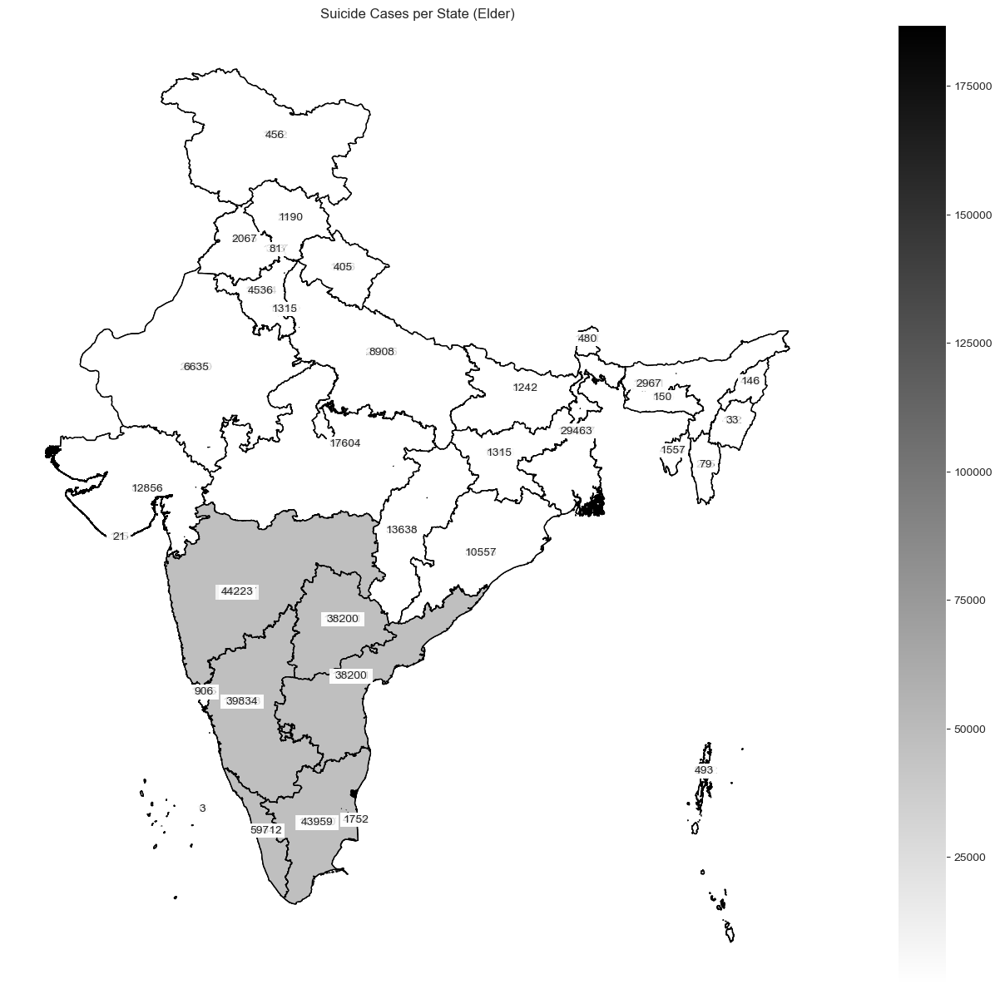

In [36]:
fig, ax = plt.subplots(figsize=(22, 15))

cmap = 'binary'

ax = suicide_map_elder.plot(ax=ax, cmap=cmap,column = 'Total',scheme = 'equal_interval',edgecolor = 'black')
ax.set_facecolor('white')
ax.set_title('Suicide Cases per State (Elder)')

suicide_map_elder['coords'] = suicide_map_elder['geometry'].apply(lambda x: x.representative_point().coords[:])
suicide_map_elder['coords'] = [coords[0] for coords in suicide_map_elder['coords']]

for idx, row in suicide_map_elder.iterrows():
   ax.text(row.coords[0], row.coords[1], s=row['Total'], 
           horizontalalignment='center', bbox={'facecolor': 'white', 'alpha':0.8, 'pad': 2, 'edgecolor':'none'})

norm = matplotlib.colors.Normalize(vmin=suicide_map_elder['Total'].min(), vmax= suicide_map_elder['Total'].max())
n_cmap = cm.ScalarMappable(cmap= cmap, norm = norm)
n_cmap.set_array([])
ax.get_figure().colorbar(n_cmap)

plt.xticks([])
plt.yticks([])
plt.show()

In [37]:
# GENDER

In [38]:
# 4.1 Barplot by Gender

In [39]:
import plotly.express as px

df = px.data.tips()
fig = px.histogram(suicides, x="Gender", y='Total',color = 'Gender',
                   color_discrete_sequence=['indianred','lightblue'],
                   marginal=None, # or violin, rug
                  )

fig.update_layout(
    title="Gender-wise Distinction",
    xaxis_title="Gender",
    yaxis_title="Total count",
)

fig.show()

In [40]:
suicides_sex = suicides.groupby(['Gender','State']).sum()

C:\Users\DELL\AppData\Local\Temp\ipykernel_25696\2827380408.py:1: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



In [41]:
# 4.3 State-wise Suicide Mapping (Female)

C:\Users\DELL\AppData\Local\Temp\ipykernel_25696\3504598526.py:22: MatplotlibDeprecationWarning:

Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.



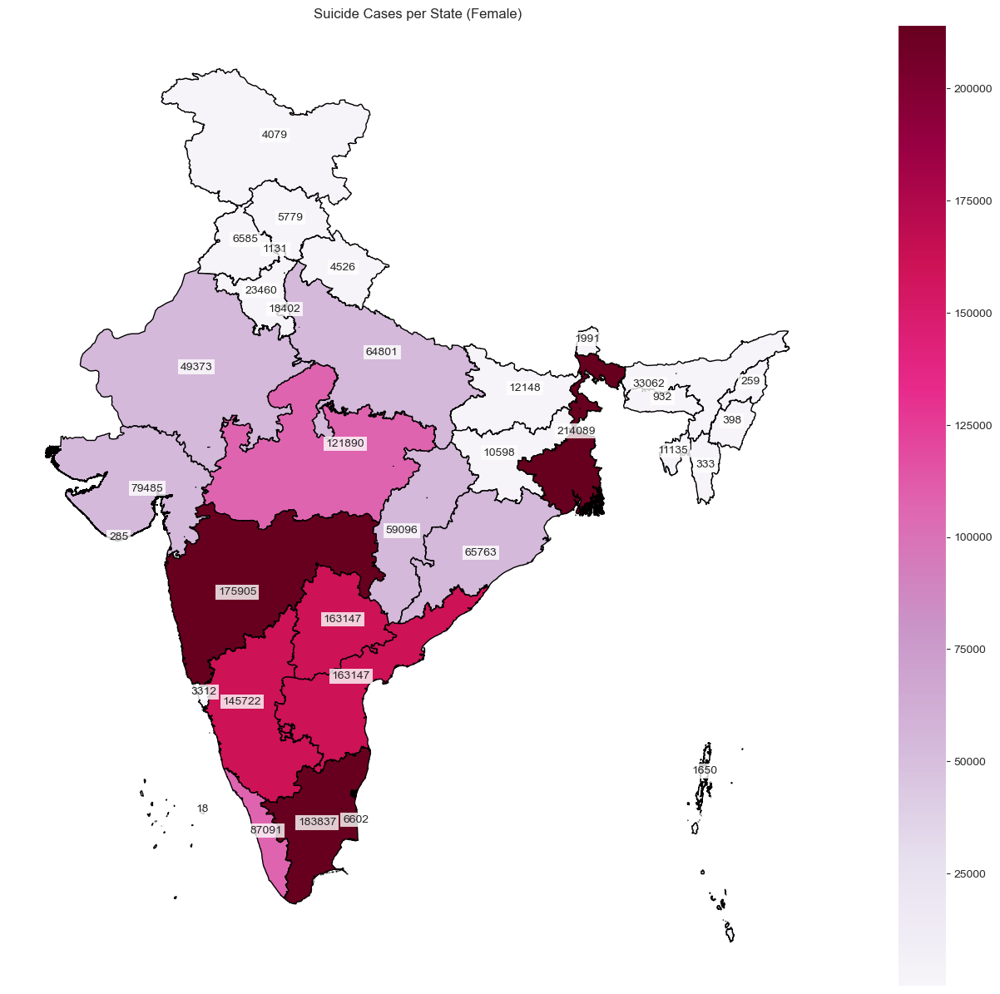

In [42]:
suicide_map_female = india.merge(suicides_sex[:suicides_sex.shape[0]//2], left_on= 'State', right_on = 'State')
suicide_map_male = india.merge(suicides_sex[suicides_sex.shape[0]//2:], left_on = 'State', right_on = 'State')

fig, ax = plt.subplots(figsize=(22, 15))

cmap = 'PuRd'

ax = suicide_map_female.plot(ax=ax, cmap=cmap,column = 'Total',scheme = 'equal_interval',edgecolor = 'black')
ax.set_facecolor('white')
ax.set_title('Suicide Cases per State (Female)')

suicide_map_female['coords'] = suicide_map_female['geometry'].apply(lambda x: x.representative_point().coords[:])
suicide_map_female['coords'] = [coords[0] for coords in suicide_map_female['coords']]

for idx, row in suicide_map_female.iterrows():
   ax.text(row.coords[0], row.coords[1], s=row['Total'], 
           horizontalalignment='center', bbox={'facecolor': 'white', 'alpha':0.8, 'pad': 2, 'edgecolor':'none'})

norm = matplotlib.colors.Normalize(vmin=suicide_map_female['Total'].min(), vmax= suicide_map_female['Total'].max())
n_cmap = cm.ScalarMappable(cmap= cmap, norm = norm)
n_cmap.set_array([])
ax.get_figure().colorbar(n_cmap)

plt.xticks([])
plt.yticks([])
plt.show()

In [43]:
# 4.4 State-wise Suicide Mapping (Male)

C:\Users\DELL\AppData\Local\Temp\ipykernel_25696\4173319198.py:19: MatplotlibDeprecationWarning:

Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.



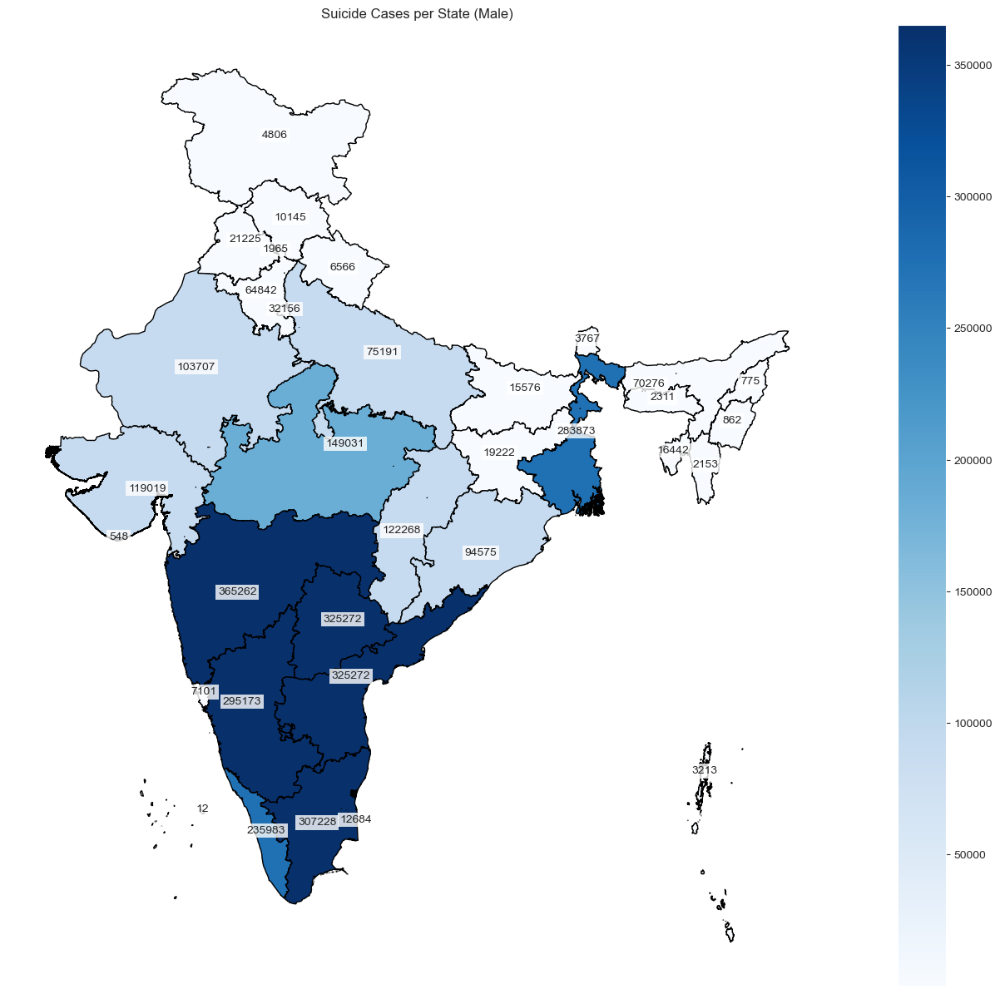

In [44]:
fig, ax = plt.subplots(figsize=(22, 15))

cmap = 'Blues'

ax = suicide_map_male.plot(ax=ax, cmap=cmap,column = 'Total',scheme = 'equal_interval',edgecolor = 'black')
ax.set_facecolor('white')
ax.set_title('Suicide Cases per State (Male)')

suicide_map_male['coords'] = suicide_map_male['geometry'].apply(lambda x: x.representative_point().coords[:])
suicide_map_male['coords'] = [coords[0] for coords in suicide_map_male['coords']]

for idx, row in suicide_map_male.iterrows():
   ax.text(row.coords[0], row.coords[1], s=row['Total'], 
           horizontalalignment='center', bbox={'facecolor': 'white', 'alpha':0.8, 'pad': 2, 'edgecolor':'none'})

norm = matplotlib.colors.Normalize(vmin=suicide_map_male['Total'].min(), vmax= suicide_map_male['Total'].max())
n_cmap = cm.ScalarMappable(cmap= cmap, norm = norm)
n_cmap.set_array([])
ax.get_figure().colorbar(n_cmap)

plt.xticks([])
plt.yticks([])
plt.show()

In [45]:
# 5. Occupation

In [46]:
# 5.1 Major Breakdown - Generic Causes, Adoption and Professional Reason

In [47]:
suicides_type = suicides.groupby(['Type_code','Year']).sum()
dist_df = suicides_type.reset_index(level=[0,1]) #Multi-index to Single-index

trace0 = go.Box(y=dist_df.loc[dist_df['Type_code']=='Causes']['Total'],name="Causes")
trace1 = go.Box(y=dist_df.loc[dist_df['Type_code']=='Means_adopted']['Total'],name="Adoption")
trace2 = go.Box(y=dist_df.loc[dist_df['Type_code']=='Professional_Profile']['Total'],name="Professional")
data = [trace0,trace1,trace2]

#fig = px.box(dist_df, y='Year', x="Total", points="all", color = 'Type_code')
iplot(data)

C:\Users\DELL\AppData\Local\Temp\ipykernel_25696\1702721722.py:1: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



In [48]:
# 5.2 By Minor Labels - Indepth Causes (Minor Types)

In [49]:
# 5.2.1 All Minor Labels

In [50]:
suicides['Type'].unique()

array(['Love Affairs', 'Other Causes (Please Specity)',
       'Other Prolonged Illness', 'Failure in Examination',
       'Causes Not known', 'Family Problems', 'Insanity/Mental Illness',
       'Death of Dear Person', 'By Hanging', 'By Fire/Self Immolation',
       'By Consuming Other Poison', 'By Drowning', 'Student',
       'Others (Please Specify)', 'House Wife', 'Service (Private)',
       'Public Sector Undertaking', 'Service (Government)',
       'Farming/Agriculture Activity', 'Retired Person', 'Unemployment',
       'Self-employed (Business activity)', 'Fall in Social Reputation',
       'Suspected/Illicit Relation',
       'Cancellation/Non-Settlement of Marriage',
       'Not having Children(Barrenness/Impotency', 'Poverty',
       'By Consuming Insecticides', 'By Other means (please specify)',
       'Unemployed', 'Professional/Career Problem', 'Paralysis',
       'Bankruptcy or Sudden change in Economic', 'Divorce', 'Cancer',
       'Property Dispute', 'By touching electr

In [51]:
suicides['Type'].replace({'Others (Please Specify)':'Unspecified',
                      'Causes Not Known':'Unspecified',
                       'Causes Not known':'Unspecified',
                       'Other Causes (Please Specity)':'Unspecified',
                       'By Other means (please specify)':'Unspecified',
                       'By Other means' : 'Unspecified',
                       'Unemployment':'Unemployed'
                      },inplace = True)

In [52]:
fig = px.histogram(suicides, x="Total", y="Type", color = 'Gender',
                   marginal="violin", # or violin, rug,
                   color_discrete_sequence=['indianred','lightblue'],
                   )

fig.update_layout(
    title="Suicide Cause",
    xaxis_title="Total Suicide Count",
    yaxis_title="Suicide Cause/Method",
)
fig.update_yaxes(tickangle=-30, tickfont=dict(size=7.5))

fig.show()

In [53]:
# 5.2.2 Crosschecking Numbers - Unspecified count

In [54]:
#From Above chart, Unspecified stands at 759k + 307k = 1066k cases of suicide approx

suicides.loc[suicides['Type']=='Unspecified']['Total'].sum()/1000

1066.343

In [55]:
# 5.2.3 Top 20 Minor Labels (for cumulative Suicide count of both Genders)

In [56]:
temp_df = suicides.groupby('Type').sum()['Total']
temp_df = temp_df.reset_index()
temp_df = temp_df.sort_values(by = ['Total'],ascending = False)
temp_df = temp_df[:20]
temp_df.rename(columns = {'Type':'Type Minor',
                          'Total':'Total Cases'},inplace = True)

C:\Users\DELL\AppData\Local\Temp\ipykernel_25696\1467283481.py:1: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



In [57]:
temp_df = temp_df.reset_index()
temp_df.drop(columns = ['index'],inplace = True)

In [58]:
hist_dict = dict(zip(temp_df['Type Minor'], temp_df['Total Cases']))
hist_dict.keys()

dict_keys(['Unspecified', 'By Hanging', 'Family Problems', 'House Wife', 'By Consuming Insecticides', 'By Consuming Other Poison', 'Farming/Agriculture Activity', 'Other Prolonged Illness', 'Unemployed', 'By Fire/Self Immolation', 'Service (Private)', 'By Drowning', 'Insanity/Mental Illness', 'Self-employed (Business activity)', 'Student', 'By coming under running vehicles/trains', 'Love Affairs', 'Professional Activity', 'Bankruptcy or Sudden change in Economic', 'Poverty'])

In [59]:
to_select = ['Unspecified', 'By Hanging', 'Family Problems', 'House Wife', 'By Consuming Insecticides', 'By Consuming Other Poison',
             'Farming/Agriculture Activity', 'Other Prolonged Illness', 'Unemployed', 'By Fire/Self Immolation', 'Service (Private)', 
             'By Drowning', 'Insanity/Mental Illness', 'Self-employed (Business activity)', 'Student', 'By coming under running vehicles/trains',
             'Love Affairs', 'Professional Activity', 'Bankruptcy or Sudden change in Economic', 'Poverty']

super_temp = suicides.loc[suicides['Type'].isin(to_select)]

In [60]:
i = 10
for key in hist_dict:
    
    hist_dict[key] = str(i)+" "+key
    i +=1

In [61]:
super_temp['Type'].replace(hist_dict, inplace = True)

C:\Users\DELL\AppData\Local\Temp\ipykernel_25696\903387183.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [62]:
super_temp = super_temp.drop(super_temp[(super_temp['Type'] == '10 Unspecified')].index)

fig = px.histogram(super_temp, x="Total", y="Type", color = 'Gender',
                   marginal='violin', # or violin, rug,
                   color_discrete_sequence=['lightblue','indianred'],
                   ).update_yaxes(categoryorder = 'category descending')

fig.update_layout(
    title="Suicide Cause",
    xaxis_title="Total Suicide Count",
    yaxis_title="Suicide Cause/Method",
)
fig.update_yaxes(tickangle=-30, tickfont=dict(size=7.5))

fig.show()

In [63]:
# 6. Comparisions

In [64]:
# 6.1 Age Groups vs Year vs Gender vs Suicide Count

In [65]:
fig = px.scatter_3d(suicides,x="Year",y="Age_group",z="Total",
    color = 'Gender', size_max = 18,
    color_discrete_sequence=['indianred','lightblue']
    )

fig.show()

In [66]:
# 6.2 Age and Gender vs Suicide Count

In [67]:
import plotly.express as px

fig = px.histogram(suicides, x="Age_group", y="Total", color="Gender",
                   color_discrete_sequence=['indianred','lightblue'],
                   marginal="violin", # or violin, rug
                  )

fig.update_layout(
    xaxis_title="Age Group",
    yaxis_title="Suicide count",
)
fig.update_yaxes(tickangle=-30, tickfont=dict(size=7.5))

fig.show()

In [68]:
# 6.3 Suicide distribution by Major Occupation/Causes Labels

In [69]:
super_temp2 = suicides.groupby(['Type_code','Gender']).sum()
super_temp2 = super_temp2.reset_index()
super_temp2 = super_temp2.sort_values(by = ['Gender'])

girl_occupation_suicide = super_temp2.iloc[:3]
boy_occupation_suicide = super_temp2.iloc[3:]

C:\Users\DELL\AppData\Local\Temp\ipykernel_25696\3622371288.py:1: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



In [70]:
import plotly.graph_objects as go

occupations_major = ['Causes','Means_adopted','Professional Profile']
female_death = list(super_temp2['Total'][:3])
male_death = list(super_temp2['Total'][3:])

fig = go.Figure()

fig.add_trace(go.Scatterpolar(
      r=male_death,
      theta=occupations_major,
      fill='toself',
      name='Male',
    line_color ="lightblue"
))

fig.add_trace(go.Scatterpolar(
      r=female_death,
      theta=occupations_major,
      fill='toself',
      name='Female',
    line_color ="indianred"
))

#fig = px.line_polar(boy_occupation_suicide, r='Total', theta='Type_code', line_close=True)
fig.update_layout(
  polar=dict(
    radialaxis=dict(
      visible=True,
      range=[0,1000000]
    )),
  showlegend=True
)

fig.update_traces(fill='toself')
fig.show()

In [71]:
#6.4 Suicide distribution by Major Occupation/Causes Labels

In [72]:
indexes = suicides.groupby('Type').sum()
indexes.sort_values(by = ['Total'], ascending = False)[1:11].index

C:\Users\DELL\AppData\Local\Temp\ipykernel_25696\985368510.py:1: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



Index(['By Hanging', 'Family Problems', 'House Wife',
       'By Consuming Insecticides', 'By Consuming Other Poison',
       'Farming/Agriculture Activity', 'Other Prolonged Illness', 'Unemployed',
       'By Fire/Self Immolation', 'Service (Private)'],
      dtype='object', name='Type')

In [73]:
super_temp3 = suicides.groupby(['Gender','Type']).sum()
super_temp3 = super_temp3.reset_index()

C:\Users\DELL\AppData\Local\Temp\ipykernel_25696\3718709265.py:1: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



In [74]:
to_choose = ['By Hanging', 'Family Problems', 'House Wife',
       'By Consuming Insecticides', 'By Consuming Other Poison',
       'Farming/Agriculture Activity', 'Other Prolonged Illness', 'Unemployed',
       'By Fire/Self Immolation', 'Service (Private)']

super_temp3_female = super_temp3.loc[ (super_temp3['Type'].isin(to_choose)) & (super_temp3['Gender']=='Female')]
super_temp3_male = super_temp3.loc[ (super_temp3['Type'].isin(to_choose)) & (super_temp3['Gender']=='Male')]

super_temp3_male = super_temp3_male.append({'Type':'House Wife',
                        'Gender':'Male',
                        'Year':0,
                        'Total':0},ignore_index = True)

super_temp3_male = super_temp3_male.sort_values(by = ['Type'])
super_temp3_female = super_temp3_female.sort_values(by = ['Type'])

C:\Users\DELL\AppData\Local\Temp\ipykernel_25696\2407754943.py:9: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



In [75]:
# Cummulative Suicide Placard

C:\Users\DELL\AppData\Local\Temp\ipykernel_25696\2099771825.py:3: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.

C:\Users\DELL\AppData\Local\Temp\ipykernel_25696\2099771825.py:3: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



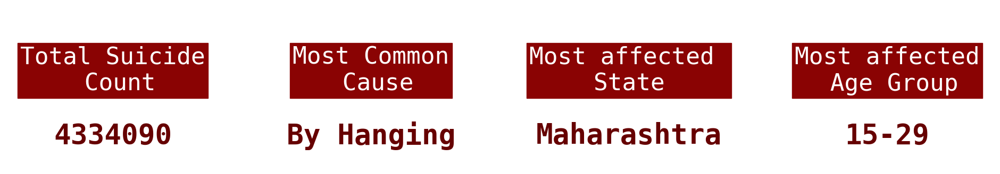

In [76]:
col = ['Total Suicide\n Count', 'Most Common\n Cause', 'Most affected \nState', 'Most affected\n Age Group',]

values = [suicides.groupby('Gender').sum()['Total']['Female'] + suicides.groupby('Gender').sum()['Total']['Male'],'By Hanging','Maharashtra','15-29']
color_val = ['lightblue','lightblue','lightblue','lightblue']

fig, axes = plt.subplots(1, 4, figsize=(24, 4))
axes = axes.flatten()
fig.set_facecolor('white')

for ind, col in enumerate(col):
    axes[ind].text(0.5, 0.6, col, 
            ha='center', va='center',
            fontfamily='monospace', fontsize=32,
            color='white', backgroundcolor='#8A0303')

    axes[ind].text(0.5, 0.2, values[ind], 
            ha='center', va='center',
            fontfamily='monospace', fontsize=38, fontweight='bold',
            color='#660000', backgroundcolor='white')
    
    axes[ind].set_axis_off()

In [77]:
# Male Suicide Placard

C:\Users\DELL\AppData\Local\Temp\ipykernel_25696\156178929.py:3: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



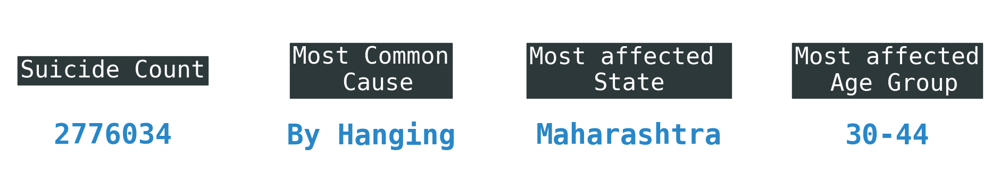

In [78]:
col = ['Suicide Count', 'Most Common\n Cause', 'Most affected \nState', 'Most affected\n Age Group',]

values = [suicides.groupby('Gender').sum()['Total']['Male'],'By Hanging','Maharashtra','30-44']

fig, axes = plt.subplots(1, 4, figsize=(24, 4))
axes = axes.flatten()
fig.set_facecolor('white')

for ind, col in enumerate(col):
    axes[ind].text(0.5, 0.6, col, 
            ha='center', va='center',
            fontfamily='monospace', fontsize=32,
            color='white', backgroundcolor='#2D383A')

    axes[ind].text(0.5, 0.2, values[ind], 
            ha='center', va='center',
            fontfamily='monospace', fontsize=38, fontweight='bold',
            color='#2887C8', backgroundcolor='white')
    
    axes[ind].set_axis_off()

In [79]:
# Female Suicide Placard

C:\Users\DELL\AppData\Local\Temp\ipykernel_25696\4281153038.py:3: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



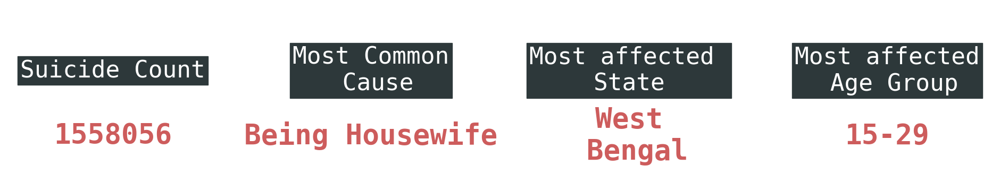

In [80]:
col = ['Suicide Count', 'Most Common\n Cause', 'Most affected \nState', 'Most affected\n Age Group',]

values = [suicides.groupby('Gender').sum()['Total']['Female'],'Being Housewife','West\n Bengal','15-29']

fig, axes = plt.subplots(1, 4, figsize=(24, 4))
axes = axes.flatten()
fig.set_facecolor('white')

for ind, col in enumerate(col):
    axes[ind].text(0.5, 0.6, col, 
            ha='center', va='center',
            fontfamily='monospace', fontsize=32,
            color='white', backgroundcolor='#2D383A')

    axes[ind].text(0.5, 0.2, values[ind], 
            ha='center', va='center',
            fontfamily='monospace', fontsize=38, fontweight='bold',
            color='indianred', backgroundcolor='white')
    
    axes[ind].set_axis_off()